In [1]:
import numpy as np
import matplotlib.pyplot as plt
from plotly.subplots import make_subplots
import plotly.graph_objects as go

# Single neuron

![experiment schematic](figs/single_cell_recording.png "Single cell recording")
![simplified system](figs/singe_cell_sim.svg)

This simplified model of a neuron is mathematically expressed with a first-order ordinary differential equation:

$$
\tau \frac{d r(t)}{dt} = -r(t) + I(t)
$$

which we can discretize in time (in steps $dt$) in order to simulate numerically using the Euler method:

$\tau \frac{r(t+dt) - r(t)}{dt} = -r(t) + I(t) \; \; \; $ so that:  $\; \; \; r(t+dt) = r(t) + \frac{dt}{\tau} \left[ -r(t) + I(t) \right]$

Here is a piece of code that simulates how a neuron with membrane time constant $\tau$ integrates a time varying input and generates a rate output $r(t)$


In [2]:

def simulate_single_neuron():

    # Time parameters
    dt = 0.001  # time step, in s
    T = 5  # simulation time in s
    t = np.arange(0, T, dt) # step times of the whole simulation, in s
    Nt = len(t) # total number of steps in simulation
    
    # Model parameters
    tau = 0.020  # membrane time constant, in s

    # Initialize populations
    rate = np.ones(Nt)

    # Stimulus input
    input = 10 * np.ones((Nt))

    # Euler Integration
    for i in range(Nt - 1):
        rate[i+1] = rate[i] + dt/tau * (-rate[i] + input[i])

    return t, input, rate


In [3]:

def plot_input_output(t, input, rate):
    # Plotting
    fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(8, 6), sharex=True, gridspec_kw={'height_ratios': [1, 3]})
    ax0.plot(t, input, color='black', label='Stimulus')
    ax0.set_ylabel('Stimulus')
    ax1.plot(t, rate, color='crimson', lw=2, label='rate')
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Firing Rate')
    ax1.legend()
    plt.tight_layout()
    plt.show()


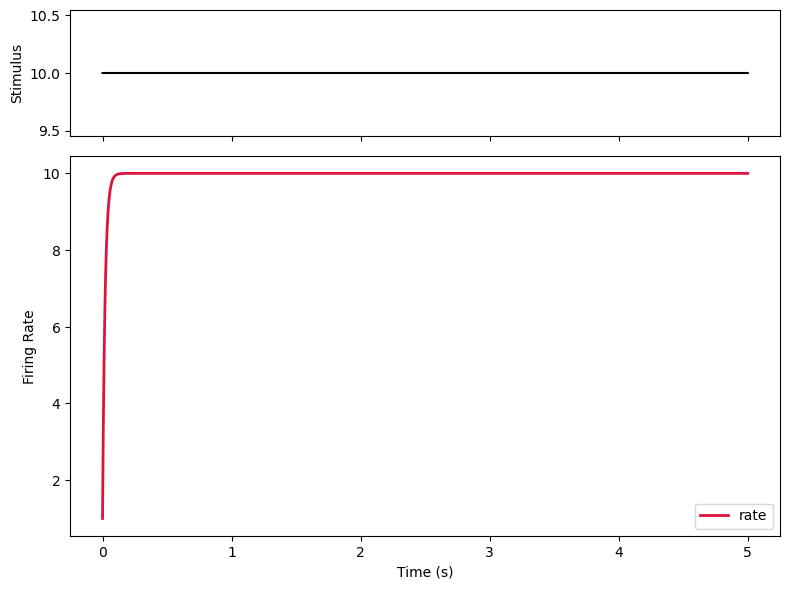

In [4]:

# Run the simulation
t, input, rate = simulate_single_neuron()

# Plot the results
plot_input_output(t, input, rate)


Now change the code above to see how a neuron with a much longer time constant (e.g. $\tau = 1 s$) would integrate this same input. What do you see?

Now compare again the two neurons, one with short time constant ($\tau = 0.02$ s) and one with very long time constant ($\tau = 10$ s), but now have them respond to an input representing a current pulse, as per the code below:

In [5]:
input = np.ones((Nt))
input[t == 1] = 3

What do you see?

Now do the same thing but for an input consisting in a train of successive current pulses:

In [6]:
input = np.ones((Nt))
input[np.isin(t, [1, 2, 3, 4])] = 3

This is quite exciting: a single neuron can do things such as memory, or stimulus counting (integration)... but, what is a realistic membrane time constant in the brain? 20 ms!

How could the brain do memory or stimulus integration if neurons have such slow time constant? Networks! Here is the simplest possible network:

# Neuron with autapse

![Autapse](figs/autapse.svg "Autapse")

Now this simplified network model of a neuron is mathematically expressed with this first-order ordinary differential equation:

$$
\tau \frac{d r(t)}{dt} = -r(t) + J r(t) + I(t)
$$

where $J$ is the strength of the self-coupling of the neuron with itself (autapse). We again discretize this equation in time (in steps $dt$) using the Euler method to get:

$r(t+dt) = r(t) + \frac{dt}{\tau} \left[ (J - 1) r(t) + I(t) \right]$

Now try simulating this equation for various values of $J$ (restricted to be non-negative, $J \ge 0$) when the neuron has a short membrane time constant (keep fixed $\tau = 0.02$ s):

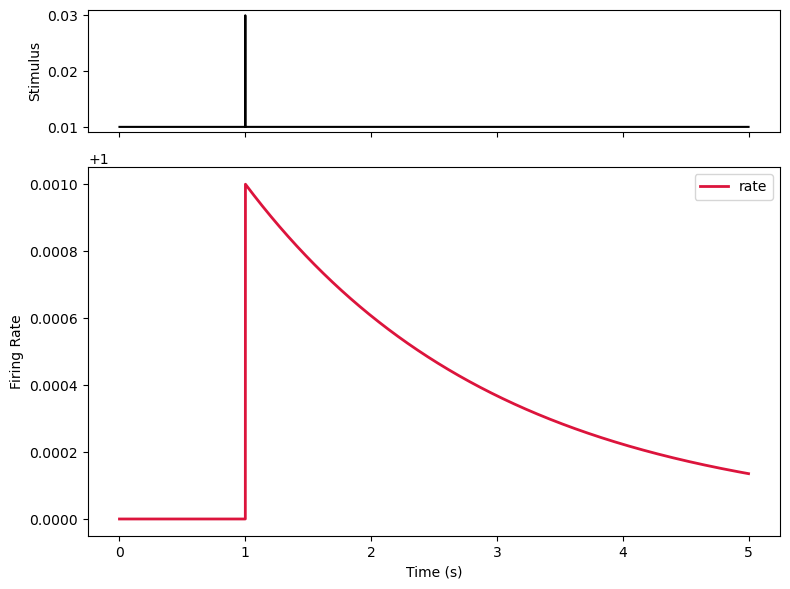

In [7]:

def simulate_autapse(J = 0.99):
# J is the coupling strength
    
    # Time parameters
    dt = 0.001  # time step, in s
    T = 5  # simulation time in s
    t = np.arange(0, T, dt) # step times of the whole simulation, in s
    Nt = len(t) # total number of steps in simulation
    
    # Model parameters
    tau = 0.020  # membrane time constant, in s
    # J = 0.99  # coupling strength (passed to the function as an argument)

    # Initialize populations
    rate = np.ones(Nt)

    # Stimulus input
    input = np.ones((Nt))
    input[t == 1] = 3
    input = input * np.abs(1 - J)

    # Euler Integration
    for i in range(Nt - 1):
        rate[i+1] = rate[i] + dt/tau * (-rate[i] + J * rate[i] + input[i])

    return t, input, rate

# Run the simulation
t, input, rate = simulate_autapse()

# Plot the results
plot_input_output(t, input, rate)


You can play with $J$ in the above code, or make a more sophisticated plot using the **Plotly** graphics library that allows you to interact with the plot directly. Here is the code and look at the result in the cell below it:

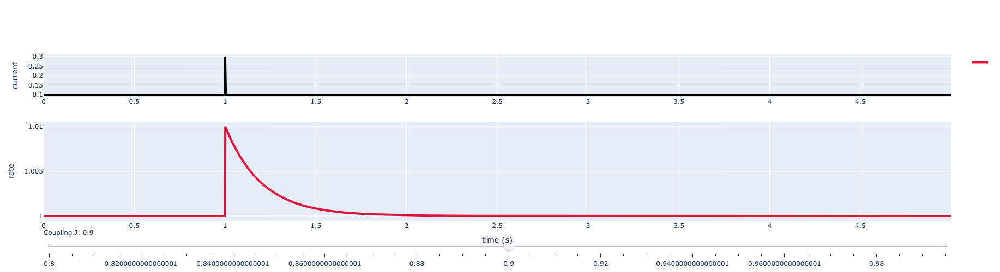

In [8]:

# Create figure
fig = make_subplots(rows=2, cols=1, row_heights=[0.3, 0.7])

# Add traces, one for each slider step
for step in np.arange(0.8, 1, 0.005):
    t, input, rate = simulate_autapse(step)
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color="crimson", width=4),
            name="",
            x = t,
            y = rate),
            row = 2, col = 1)
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color="black", width=4),
            name="",
            x = t,
            y = input,
            showlegend = False),
            row = 1, col = 1)

# Make 10th trace visible
mid = len(fig.data)//2
fig.data[mid].visible = True
fig.data[mid+1].visible = True

# Create and add slider
steps = []
for i in range(len(fig.data)//2):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)}],
        label=str(0.005 * i + 0.8) # layout attribute
    )
    step["args"][0]["visible"][2*i] = True  # Toggle i'th trace to "visible"
    step["args"][0]["visible"][2*i+1] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=mid/2,
    currentvalue={"prefix": "Coupling J: "},
    pad={"t": 10},
    steps=steps
)]

fig.update_layout(
    sliders=sliders, height=500, width=600
)

fig.update_xaxes(title_text="", range=[0, np.max(t)], row=1, col=1)
fig.update_xaxes(title_text="time (s)", range=[0, np.max(t)], row=2, col=1)
fig.update_yaxes(title_text="current",  row=1, col=1)
fig.update_yaxes(title_text="rate",  row=2, col=1)


In what conditions does this network show perfect memory (i.e. it has a different rate depending on whether a stimulus was presented in the past or not)?

What happens if you set $J>1$?

So, through recurrent connections, neurons with short membrane time constants can achieve memory and integration capabilities as if they had long time constants. This is one of the fundamental principles of network function in attractor networks.

Now let's address the issues with this simple network function: fine-tuning of memory ($J=1$) and instabilities when $J > 1$. Let us consider a fundamental architectural motif in neural circuits in the cerebral cortex: neurons are either excitatory or inhibitory, and are strongly coupled with one another.

# The E-I circuit

We thus consider two neurons, one excitatory, one inhibitory, mutually connected. The network model is now mathematically expressed with this system of coupled first-order ordinary differential equations:

$$
\tau \frac{d r_E(t)}{dt} = -r_E(t) + G_E \left[ W_{EE} r_E(t) - W_{EI} r_I(t) + I_E(t) - \theta_E \right]_{+}
$$

$$
\tau \frac{d r_I(t)}{dt} = -r_I(t) + G_I \left[ W_{IE} r_E(t) - W_{II} r_I(t) + I_I(t) - \theta_I \right]_{+}
$$

where $W_{XY}$ are all non-negative and denote the strengths of the couplings between neuron $X$ and neuron $Y$. To ensure that firing rates are positive, we apply a linear-threshold transformation $G [\;I - \theta ]_{+}$ to the inputs, with thresholds $\theta_E$ and $\theta_I$. We again discretize this equation in time (in steps $dt$) using the Euler method to get:

$$
r_E(t+dt) = r_E(t) + \frac{dt}{\tau} \left( -r_E(t) + G_E \left[ W_{EE} r_E(t) - W_{EI} r_I(t) + I_E(t) - \theta_E \right]_+ \right)
$$

$$
r_I(t+dt) = r_I(t) + \frac{dt}{\tau} \left( -r_I(t) + G_I \left[ W_{IE} r_E(t) -W_{II} r_I(t) + I_I(t) - \theta_I \right]_+ \right)
$$

This system now is quite rich and can display a number of interesting dynamics. For instance, it can show the memory function that we discussed, but in a much more robust system. You can play with connectivity strengths in this code and convince you that this perfect memory is not subject to strict fine-tuning, thanks to the interaction of excitation and inhibition. For a detailed analysis of this system dynamics, you can explore this article by [Jercog et al. (2017)](https://doi.org/10.7554/eLife.22425).

In [9]:

def simulate_EI_circuit(GE = 1):
# GE is the gain of excitatory neurons

    # Time parameters
    dt = 0.001  # time step, in s
    T = 1.5  # simulation time in s
    t = np.arange(0, T, dt) # step times of the whole simulation, in s
    Nt = len(t) # total number of steps in simulation
    
    # Model parameters
    tauE = 0.03  # membrane time constant of excitatory neurons, in s
    tauI = 0.01  # membrane time constant of inhibitory neurons, in s
    thresholdE = 0.5  # threshold of excitatory neurons
    thresholdI = 25  # threshold of inhibitory neurons
    # GE = 1  # gain of excitatory neurons (this is an argument to the function)
    GI = 4  # gain of inhibitory neurons    
    WEE = 5    # E to E coupling strength
    WEI = 1    # I to E coupling strength
    WIE = 10   # E to I coupling strength
    WII = 0.5  # I to I coupling strength

    # Transfer function
    def phi(x, threshold):
        """
        Computes the rectified linear response (ReLU) relative to a threshold.
        """
        return np.maximum(0, x - threshold)
    
    # Initialize populations
    rateE, rateI = np.zeros(Nt), np.zeros(Nt)
    
    # Stimulus input
    input = np.zeros((Nt))
    input[(t > 0.3) & (t < 0.3 + 0.15)] = 0.6  # small input to population E1, from 1000 ms to 1150 ms
    
    # Euler Integration
    for i in range(Nt - 1):
        rateE[i+1] = rateE[i] + dt/tauE * (-rateE[i] + GE * phi(WEE * rateE[i] - WEI * rateI[i] + input[i], thresholdE) )
        rateI[i+1] = rateI[i] + dt/tauI * (-rateI[i] + GI * phi(WIE * rateE[i] - WII * rateI[i], thresholdI) )

    return t, input, rateE, rateI


In [10]:

def plot_input_output_EI(t, input, rateE, rateI):
    # Plotting
    fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(8, 6), sharex=True, gridspec_kw={'height_ratios': [1, 3]})
    ax0.plot(t, input, color='black', label='Stimulus')
    ax0.set_ylabel('Stimulus')
    ax1.plot(t, rateE, color='crimson', lw=2, label='E-cell')
    ax1.plot(t, rateI, color='royalblue', lw=2, label='I-cell')
    ax1.set_xlabel('Time (s)')
    ax1.set_ylabel('Firing Rate')
    ax1.legend()
    plt.tight_layout()
    plt.show()


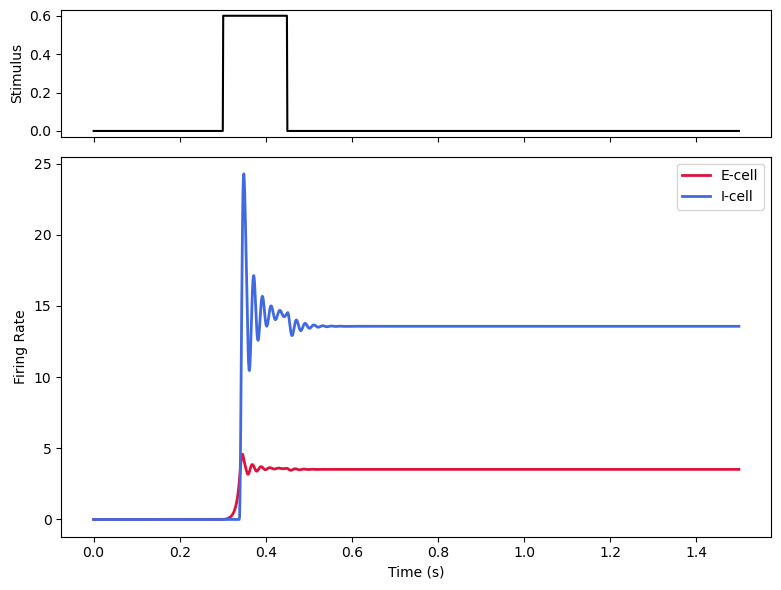

In [11]:

# Run the simulation
t, input, rateE, rateI = simulate_EI_circuit()

# Plot the results
plot_input_output_EI(t, input, rateE, rateI)


As an exercise, explore in this simulation the results of the phase space analysis shown in class. Vary the strength of the input to the excitatory population. Try setting $W_{EE}$ outside the range of bistability, or move close and far of the bifurcation and interpret what you see.

Again, here we have an interactive plot to explore the effect of $G_E$ on the stability of the network activity:

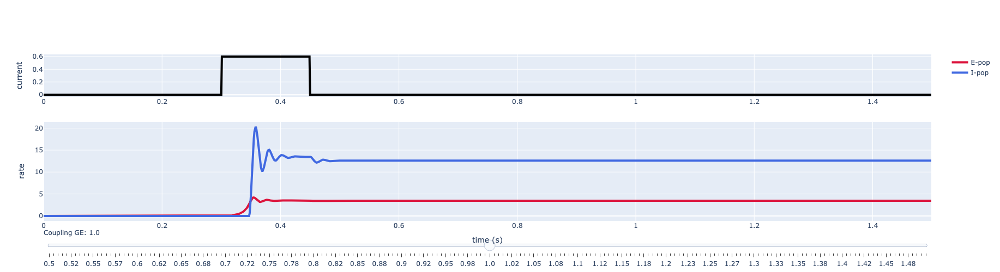

In [12]:

# Create figure
fig = make_subplots(rows=2, cols=1, row_heights=[0.3, 0.7])

# Add traces, one for each slider step
for step in np.arange(0.5, 1.5, 0.005):
    t, input, rateE, rateI = simulate_EI_circuit(step)
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color="crimson", width=4),
            name="E-pop",
            x = t,
            y = rateE),
            row = 2, col = 1)
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color="royalblue", width=4),
            name="I-pop",
            x = t,
            y = rateI),
            row = 2, col = 1)
    fig.add_trace(
        go.Scatter(
            visible=False,
            line=dict(color="black", width=4),
            name="",
            x = t,
            y = input,
            showlegend = False),
            row = 1, col = 1)

# Make 10th trace visible
mid = len(fig.data)//3
fig.data[mid].visible = True
fig.data[mid+1].visible = True
fig.data[mid+2].visible = True

# Create and add slider
steps = []
for i in range(len(fig.data)//3):
    step = dict(
        method="update",
        args=[{"visible": [False] * len(fig.data)}],
        label=str(np.around(0.005 * i + 0.5, 2)) # layout attribute
    )
    step["args"][0]["visible"][3*i] = True  # Toggle i'th trace to "visible"
    step["args"][0]["visible"][3*i+1] = True  # Toggle i'th trace to "visible"
    step["args"][0]["visible"][3*i+2] = True  # Toggle i'th trace to "visible"
    steps.append(step)

sliders = [dict(
    active=mid/2,
    currentvalue={"prefix": "Coupling GE: "},
    pad={"t": 10},
    steps=steps
)]

fig.update_layout(
    sliders=sliders, height=500, width=600
)

fig.update_xaxes(title_text="", range=[0, np.max(t)], row=1, col=1)
fig.update_xaxes(title_text="time (s)", range=[0, np.max(t)], row=2, col=1)
fig.update_yaxes(title_text="current",  row=1, col=1)
fig.update_yaxes(title_text="rate",  row=2, col=1)

## Advanced topic: Phase-plane analysis

Here is the code of the phase space analysis, if you want to generate other analyses:

In [13]:

# if you want to run this in Google Colab, uncomment and execute the follwing two lines

#!pip uninstall -y jax jaxlib
#!pip install jax==0.4.33 jaxlib==0.4.33 brainpy==2.7.6


I am creating the vector field ...
I am computing fx-nullcline ...
I am evaluating fx-nullcline by optimization ...
I am computing fy-nullcline ...
I am evaluating fy-nullcline by optimization ...
I am searching fixed points ...
I am trying to find fixed points by optimization ...
	There are 788 candidates
I am trying to filter out duplicate fixed points ...
	Found 3 fixed points.
	#1 rE=0.0, rI=0.0 is a stable node.
	#2 rE=0.09999999999999999, rI=0.0 is a saddle node.
	#3 rE=3.5142857142857147, rI=13.65714285714286 is a stable focus.


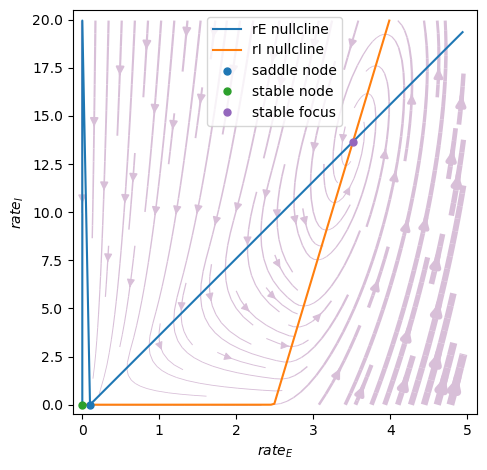

In [14]:

import brainpy as bp
import brainpy.math as bm

bm.enable_x64()
bm.set_platform('cpu')

# Model parameters
tauE = 0.03  # membrane time constant of excitatory neurons, in s
tauI = 0.01  # membrane time constant of inhibitory neurons, in s
thresholdE = 0.5  # threshold of excitatory neurons
thresholdI = 25  # threshold of inhibitory neurons
GE = 1  # gain of excitatory neurons
GI = 4  # gain of inhibitory neurons    
WEE = 5    # E to E coupling strength
WEI = 1    # I to E coupling strength
WIE = 10   # E to I coupling strength
WII = 0.5  # I to I coupling strength

def rectify(x, threshold):
    return (x - threshold) * (x > threshold)

@bp.odeint
def int_E(rE, t, rI, input=0.1, WEE = WEE, thrE = thresholdE, tauE = tauE, GE = GE):
    return - rE / tauE + GE * rectify(WEE*rE - WEI*rI + input, thrE) / tauE

@bp.odeint
def int_I(rI, t, rE, input=0.1, WIE = WIE, thrI = thresholdI, tauI = tauI, GI = GI):
    return - rI / tauI + GI * rectify(WIE*rE - WII*rI + input, thrI)  / tauI


analyzer = bp.analysis.PhasePlane2D(
    model=[int_E, int_I],
    target_vars={'rE': [0, 5], 'rI': [0, 20]},
#    pars_update={'thrE': 1},
    resolutions=0.05,
)
analyzer.plot_vector_field()
analyzer.plot_nullcline(coords=dict(rI='rE-rI'),
                        x_style={'fmt': '-'},
                        y_style={'fmt': '-'})
analyzer.plot_fixed_point()

plt.gca().set_box_aspect(1)
plt.ylabel('$rate_I$')
plt.xlabel('$rate_E$')
plt.tight_layout()


## Advanced topic: Bifurcation diagram

I am making bifurcation analysis ...
I am filtering out fixed point candidates with auxiliary function ...
I am trying to find fixed points by optimization ...
	There are 5000 candidates
I am trying to filter out duplicate fixed points ...
	Found 292 fixed points.


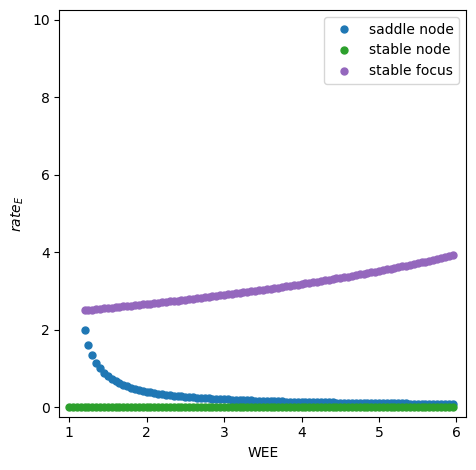

In [15]:

analyzer = bp.analysis.Bifurcation2D(
  model=[int_E, int_I],
  target_vars={'rE': [0., 10], 'rI': [0., 20.]},
  target_pars={'WEE': [1., 6.]},
  resolutions={'WEE': 0.05},
)

analyzer.plot_bifurcation(num_rank=50)

plt.close();
plt.gca().set_box_aspect(1)
plt.xlabel('WEE')
plt.ylabel('$rate_E$')
plt.tight_layout()

This system shows a robust, qualitatively similar behavior across a range of parameters values.

# Discrete attractor model

![](figs/doublewell.svg)


Now this starts getting interesting. It is straightforward to extend the previous schematic for the E-I network by incorporating several excitatory populations and a common inhibitory populaiton (in practice, we think of each unit in the network as a population of neurons, so we talk of a 3-population network). Here are the eqations of the network that we want to study.

$$
\tau \frac{d r_{E,1}(t)}{dt} = -r_{E,1}(t) + \Phi( W_{EE} r_{E,1}(t) - W_{EI} r_I(t) + I_E)
$$

$$
\tau \frac{d r_{E,2}(t)}{dt} = -r_{E,2}(t) + \Phi( W_{EE} r_{E,2}(t) - W_{EI} r_I(t) + I_E)
$$

$$
\tau \frac{d r_{I}(t)}{dt} = -r_{I}(t) + \Phi( W_{IE} (r_{E,1}(t) + r_{E,2}(t)) + I_I)
$$

Here we use the sigmoid function as the transfer function $\Phi$ (see the code for the details). Note that for simplicity we have not included inhibitory to inhibitory coupling ($W_{II}$) and excitatory neurons are only coupled within populations but not across populations (unlikey in the schematic above).

The paramters for this network were taken from this paper by [Ledberg and Roxing (2018)](https://doi.org/10.1371/journal.pcbi.1000046) that contains an in-depth analysis of the network dynamics. This network has been studied extensively in the context of perceptual decision making because in addition to working memory it is also capable of integrating inputs over time. The model is also sometimes called the [Wong and Wang model](https://doi.org/10.1523/JNEUROSCI.3733-05.2006). Their paper also describes how to simplify the system to just two dimensions (i.e., the two excitatory rates when the inhibitory neurons have faster time constants than the excitatory neurons), which simplies state-space and bifucation analysis. 


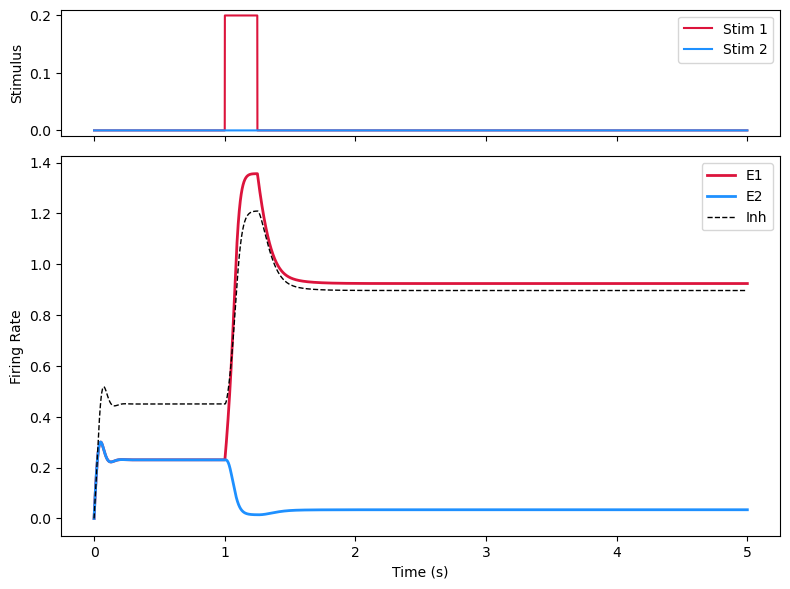

In [16]:

def simulate_3_pop():

    # Time parameters
    dt = 0.001
    T = 5
    t = np.arange(0, T, dt)
    Nt = len(t)

    # Model parameters
    tauE, tauI = 0.02, 0.02
    WEE = 1.9   # E to E connection weight (self-excitation)
    WEI = 1     # I to E connection weight
    WIE = 1     # E to I connection weight
    IE = 0.33   # external input to E cells
    II = 0.2    # external input to I cells

    # Sigmoid Transfer function
    def phi(x):
        return 1.5 / (1 + np.exp(-2.5 * (x - 1)))

    # Initialize populations
    rateE1, rateE2, rateI = np.zeros(Nt), np.zeros(Nt), np.zeros(Nt)

    # Stimulus input
    input1, input2 = np.zeros(Nt), np.zeros(Nt)
    input1[(t > 1.0) & (t < 1.25)] = 0.2  # small input to population E1, from 1000 ms to 1250 ms

    # Euler Integration
    for i in range(Nt - 1):
        rateE1[i+1] = rateE1[i] + dt/tauE * (-rateE1[i] + phi(WEE * rateE1[i] - WEI * rateI[i] + IE + input1[i]) )
        rateE2[i+1] = rateE2[i] + dt/tauE * (-rateE2[i] + phi(WEE * rateE2[i] - WEI * rateI[i] + IE + input2[i]) )
        rateI[i+1]  = rateI[i]  + dt/tauI * (-rateI[i]  + phi(WIE * (rateE1[i] + rateE2[i]) + II) )

    return t, input1, input2, rateE1, rateE2, rateI

# Run the simulation
t, input1, input2, rateE1, rateE2, rateI = simulate_3_pop()

# Plotting
fig, (ax0, ax1) = plt.subplots(2, 1, figsize=(8, 6), sharex=True, gridspec_kw={'height_ratios': [1, 3]})

ax0.plot(t, input1, color='crimson', label='Stim 1')
ax0.plot(t, input2, color='dodgerblue', label='Stim 2')
ax0.set_ylabel('Stimulus')
ax0.legend(loc='upper right')

ax1.plot(t, rateE1, color='crimson', lw=2, label='E1')
ax1.plot(t, rateE2, color='dodgerblue', lw=2, label='E2')
ax1.plot(t, rateI, color='black', lw=1, ls='--', label='Inh')
ax1.set_xlabel('Time (s)')
ax1.set_ylabel('Firing Rate')
ax1.legend()

plt.tight_layout()
plt.show()


What happens if you send the input current pulse to population 2 instead of population 1? Argue about how this model can be used to remember specific events that happened in the recent past.

These discrete attractor models have been applied to model working memory for objects. In this case there are just two possible memories, because there are two populations, but this can be generalized to an arbitrary number of discrete memories. If you want to learn more about these models, you can check [Inagaki et al. (2019)](https://www.nature.com/articles/s41586-019-0919-7) on experimental evidence supporting it.
Also, notice how this network now responds to input by establishing a competition between the two populations: if one wins, the other one loses. This is what we call "winner-take-all" dynamics and it is thought also to be a mechanism underlying multiple brain computations from sensory perception to decision making.

# Continuous bump attractor model

We have now seen a model that can do interesting computations on a few numbers of discrete items, whether memories or decisions. What about storing a continuous quantity, like a length or an angle? For this purpose, the main model studied in computational neuroscience is the ring attractor model.

![ring model](figs/ring.svg)

In this model, neurons are disposed on a ring and they are connected following a very precise connectivity scheme: neurons being close on the ring excite them more than neurons being more distant on the ring, which eventually inhibit each other effectively. Importantly, this pattern of connectivity is assumed to be translationally invariant, i.e. the strength of the connection between neuron N and neuron N + M  in the ring is exactly the same as the connection between neuron L and neuron L + M, for any N, M and L. Below I show you how to build such a connectivity scheme easily in Python. Looking at the graph below, convince yourself that this connectivity has the properties mentioned above.

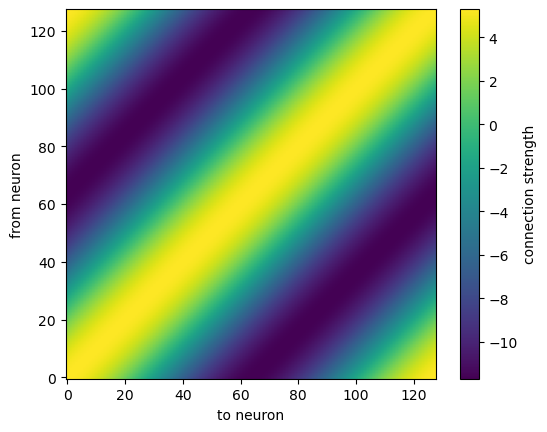

In [17]:

def get_ring_connectivity(N = 128, J0 = -3.2, J2 = 8.5):
    # N is the number of neurons on the ring
    # J0 is strength of global inhibition
    # J2 is the excitatory coupling strength with a cosine footprint

    x = np.linspace(-np.pi, np.pi, N, endpoint=False)

    cs = np.cos(x)
    sn = np.sin(x)

    J0 = -3.2
    J2 = 8.5
    J = J0 + J2 * (np.outer(cs, cs) + np.outer(sn, sn))

    return J, x

J, x = get_ring_connectivity()

# illustrate the connectivity matrix
plt.imshow(J, origin="lower")
plt.xlabel('to neuron')
plt.ylabel('from neuron')
plt.colorbar(label="connection strength");


Now let's run the dynamics of a network with this connectivity. Instead of evolving three variables, one for each of neural populations, as in the discrete attractor model before, we now will evolve a whole vector of rates `rate` containging as many rate variables as neurons in the ring. See the paper by [Wimmer et al. (2014)](https://doi.org/10.1038/nn.3645) for the network equations and further details.

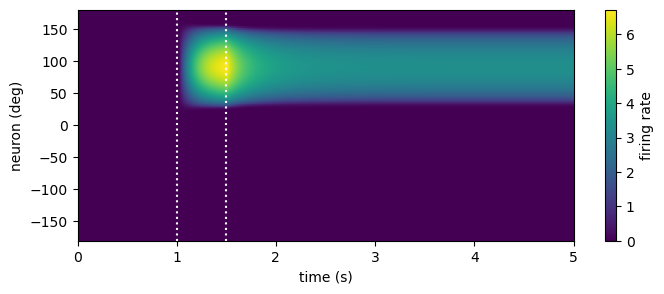

In [18]:

def simulate_ring_model(stim_loc = 90, stim_on = 1, stim_off = 1.5, noise_amp = 0):
    # stim_loc in degrees (between -180 and 180)
    # stim_on is the stimulus onset in seconds
    # stim_off is the stimulus offset in seconds
    # noise_amp is the noise amplitude
    
    # Time parameters
    dt = 0.01
    T = 5
    t = np.arange(0, T, dt)
    Nt = len(t)

    # Model parameters
    N = 128  # number of neurons on the ring
    tau = 0.1
    J, x = get_ring_connectivity(N)

    # Input-output transfer function for all cells, as used previously (Brunel, Cereb Cortex 13:1151, 2003)
    def phi(x):
        return x**2 * ((x > 0) & (x < 1)) + np.sqrt(np.abs(4*x-3)) * (x >= 1)
        
    # Initialize populations
    rate = np.zeros((Nt,N)) # vector of rates through time

    # Stimulus input
    stim = stim_loc * np.pi/180.  # convert to rad
    I = 0.1 * np.exp(4 * np.cos(x - stim))  # stimulus current
    
    # Euler Integration
    for i in range(Nt - 1):
        if (t[i] > stim_on) & (t[i] < stim_off):
            input = I #transient input at the beginning of the simulation
        else:
            input = 0
        network_inputs = np.dot(J, rate[i]) / N  # this is the network step, where currents to each neuron are computed from the connectivity J and the rates
        noise = noise_amp * np.random.randn(N,1).flatten()
        rate[i+1] = rate[i] + dt/tau * (-rate[i] + phi(network_inputs + input + noise))

    return t, rate

# Run the simulation
stim_loc = 90
stim_on = 1
stim_off = 1.5
t, rate = simulate_ring_model(stim_loc = stim_loc, stim_on = stim_on, stim_off = stim_off)

# Plotting
plt.figure(figsize=(8,3))
plt.imshow(rate.T, extent=[0,5,-180,180], aspect="auto", origin="lower")
plt.axvline(stim_on, color='w', ls=':')
plt.axvline(stim_off, color='w', ls=':')
plt.ylabel('neuron (deg)')
plt.xlabel('time (s)')
plt.colorbar(label='firing rate');
plt.show()


In this plot, the vertical dotted lines mark the period of stimulus presentation.

Play with the previous code changing:
1) the strength of the connectivity $J_2$ (try reducing it to $J_2 = 7$)
2) the location where the stimulus is presented (`stim`)

What do you observe? Is this always a good system to store continuous memories?


If we now take a snapshot of the network activity at the end of the simulation, you can see why we also often call this network a *bump attractor network*.

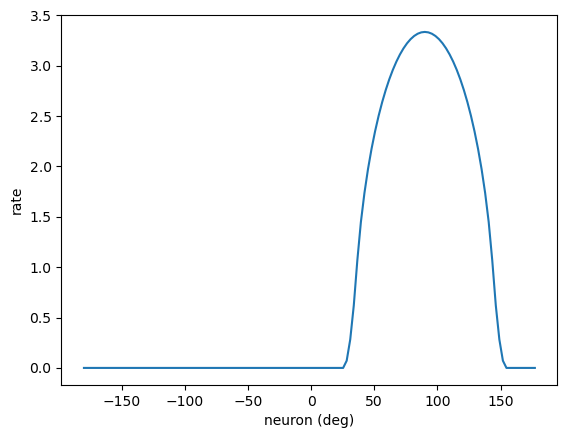

In [19]:
plt.plot(np.rad2deg(x), rate[-1]);
plt.xlabel('neuron (deg)')
plt.ylabel('rate');

Check how this bump activty profile is changing when modifying the network connectivity $J_2$ and/or the strength of the input current.

Also in this network it is interesting to explore how it reacts when it is subject to noisy inputs, simulating the embedding of the circuit in a larger system with many uncontroled and unpredictable components.

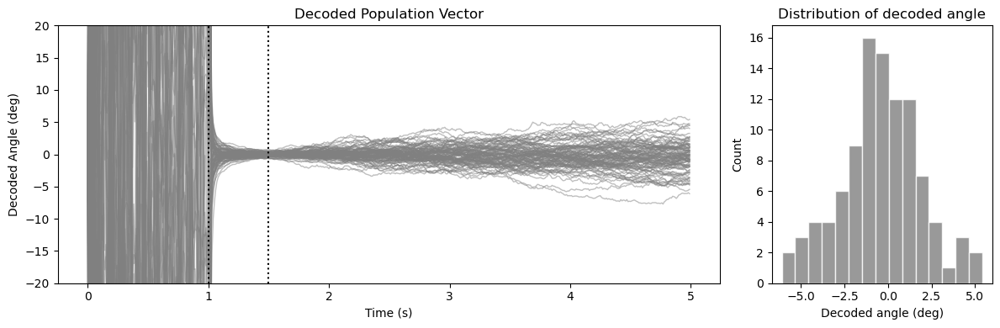

In [21]:

def decode(rate_matrix, x):
    """
    Decodes the population vector angle for a full simulation matrix.
    rate_matrix shape: (time_steps, num_neurons)
    """
    decoding_vec = np.exp(1j * x) 
    res = rate_matrix @ decoding_vec
    return np.angle(res)

# Configure simulation
nsims = 100  # numbner of simulation runs
stim_params = dict(stim_loc=0, stim_on=1, stim_off=1.5, noise_amp=0.5)
all_traces = np.zeros((nsims, len(t)))

# Run simulations
for n in range(nsims):
    t, rate = simulate_ring_model(**stim_params)
    all_traces[n, :] = np.rad2deg(decode(rate, x))

endpoints = all_traces[:, -1]

# Plot results
fig, (ax_trace, ax_hist) = plt.subplots(1, 2, figsize=(12, 4), gridspec_kw={'width_ratios': [3, 1]})
ax_trace.plot(t, all_traces.T, color='gray', alpha=0.5, lw=1)
ax_trace.set_ylim([-20, 20])
ax_trace.set_xlabel('Time (s)')
ax_trace.set_ylabel('Decoded Angle (deg)')
ax_trace.axvline(stim_params['stim_on'], color='k', ls=':', label='Stim ON')
ax_trace.axvline(stim_params['stim_off'], color='k', ls=':', label='Stim OFF')
ax_trace.set_title('Decoded Population Vector')

ax_hist.hist(endpoints, bins=15, color='gray', alpha=0.8, edgecolor='white')
ax_hist.set_xlabel('Decoded angle (deg)')
ax_hist.set_ylabel('Count')
ax_hist.set_title('Distribution of decoded angle')

plt.tight_layout()
plt.show()


How do you interpret the results of this simulation? Check what happens when you modify the noise strength or the number of neurons. What happens with memories in this network as we make the retention interval or delay period longer and longer? This is a prediction of the model that was effectively validated in neural data of the monkey prefrontal cortex. You can check it out [here](https://doi.org/10.1038/nn.3645).